# Social Networks Final Project a.a. 2023-2024
## Exploring Protein-Protein Interactions (PPIs) in the Context of COVID-19

**Group members:**

Marina Iuliana Aur, *1809715* <br>
Cristiana Di Tullio, *1803880*

## Import libraries and dependencies

In [3]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [2]:
# Run if needed
%pip install torch-geometric
%pip install markov-clustering
%pip install igraph
%pip install torchmetrics

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [4]:
# Import libraries
# General
import pandas as pd
import numpy as np
import random
import os
from PIL import Image
from tqdm.notebook import tqdm
import math
from scipy.sparse import csr_matrix
import itertools
import pprint
# Networks
import networkx as nx
import markov_clustering as mc
# Plotting
from matplotlib import pyplot as plt
import seaborn as sns
from collections import Counter
import igraph
import plotly as py
import plotly.express as px
import plotly.colors as pc
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# Deep Learning
import torch
import torch.nn as nn
from torch.optim import Adam, AdamW
from torch import no_grad, cat
import torch.nn.functional as F
from torch.cuda import is_available
from torch_geometric.data import Data
from torch_geometric.utils import to_networkx, negative_sampling
from torch_geometric.nn import GCNConv, SAGEConv, GATConv, LayerNorm
from torchmetrics.retrieval import RetrievalMRR, RetrievalHitRate
import torch_geometric.transforms as T
from torch_geometric.utils import to_networkx, negative_sampling, from_networkx
from torch_geometric.transforms import RandomLinkSplit
# Machine Learning
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import ConfusionMatrixDisplay, roc_curve
from sklearn.preprocessing import LabelEncoder

In [5]:
# CPU/GPU
device = 'cpu'
if torch.cuda.is_available():
	device = 'gpu'

print(f'Using device {device}')

Using device cpu


## Utility functions

In [6]:
def plot_3D_graph(G, node_colors, colors_legend, legend_labels=None, title='3D Graph', layt=None, spread_factor=1.0):
    '''
    Utility function to plot a NetworkX graph in 3D space.
    '''

    if layt is None:
        # Increase k to increase distance between nodes
        # (like it's the elastic constant of the layout)
        layt = nx.spring_layout(G, dim=3, k=spread_factor / np.sqrt(G.number_of_nodes()))

    # Nodes coordinates
    Xn = [layt[node][0] for node in G.nodes()]
    Yn = [layt[node][1] for node in G.nodes()]
    Zn = [layt[node][2] for node in G.nodes()]

    # Edge coordinates
    Xe = []
    Ye = []
    Ze = []
    for e in G.edges():
        Xe += [layt[e[0]][0], layt[e[1]][0], None]
        Ye += [layt[e[0]][1], layt[e[1]][1], None]
        Ze += [layt[e[0]][2], layt[e[1]][2], None]

    # Create trace for edges
    trace1 = go.Scatter3d(x=Xe,
                          y=Ye,
                          z=Ze,
                          mode='lines',
                          showlegend = False,
                          line=dict(color='rgb(125, 125, 125)', width=1),
                          hoverinfo='none'
                          )
    
    # Create hover text with node info
    hover_text = []
    for node in G.nodes():
        node_data = G.nodes[node]
        hover_text.append(
            f"ID: {node}<br>" +
            f"Symbol: {node_data.get('Symbol', 'N/A')}<br>" +
            f"Organism: {node_data.get('Organism', 'N/A')}<br>" +
            f"Degree: {node_data.get('Degree', 'N/A')}<br>" +
            f"Betweeness: {node_data.get('Betweeness', 'N/A')}<br>" +
            f"Eigen: {node_data.get('Eigen', 'N/A')}<br>" +
            f"BetoverDeg: {node_data.get('BetoverDeg', 'N/A')}"
        )

    # Create trace for nodes
    trace2 = go.Scatter3d(x=Xn,
                          y=Yn,
                          z=Zn,
                          mode='markers',
                          name='actors',
                          showlegend = False,
                          marker=dict(symbol='circle',
                                      size=6,
                                      color=node_colors,
                                      colorscale='Viridis',
                                      line=dict(color='rgb(50, 50, 50)', width=0.5)
                                      ),
                          text=hover_text,
                          hoverinfo='text'
                          )

    # Define axis properties
    axis = dict(showbackground=False,
                showline=False,
                zeroline=False,
                showgrid=True,
                showticklabels=False,
                title=''
                )

    # Create layout
    layout = go.Layout(
        title=title,
        width=1000,
        height=800,
        showlegend=True,
        legend=dict(x=1.05, y=1, traceorder='normal'),
        scene=dict(
            xaxis=dict(axis),
            yaxis=dict(axis),
            zaxis=dict(axis),
        ),
        margin=dict(
            t=100
        ),
        hovermode='closest',
    )

    # Create custom legend traces
    if legend_labels:
        legend_traces = []
        for label, color in legend_labels.items():
            legend_trace = go.Scatter3d(
                x=[None], y=[None], z=[None],  # Dummy values
                mode='markers',
                marker=dict(color=color, size=10, symbol='circle'),
                name=label
            )
            legend_traces.append(legend_trace)
        data = [trace1, trace2] + legend_traces
    else:
        data = [trace1, trace2]

    # Create figure
    fig = go.Figure(data=data, layout=layout)

    return fig


In [7]:
def print_dict(string, dictionary, n = 5):
    '''
    Utility function to display only the first n elements
    of a dictionary.
    '''

    dictionary = dict(dictionary)
    out = dict(itertools.islice(dictionary.items(), n))
    print(string)
    print("-" * len(string))
    pprint.pprint(out)
    print("")

In [8]:
def save_communities(alg_name, communities):
  '''
  Utility function for saving protein community data to text files.
  '''

  if not os.path.exists(alg_name):
        os.makedirs(alg_name)

  for id, community in enumerate(communities):
    file_path = os.path.join(alg_name, f'community_{id+1}.txt')
    with open(file_path, 'w') as file:
      for protein in community:
        symbol = map_id[protein]
        file.write(f'{symbol}\n')

In [61]:
def display_biological_process(alg_name, folder_path):
  '''
  Utility function for displaying GO Biological Process images.
  '''

  GO_BP_images = [f for f in os.listdir(folder_path) if f.endswith('.png')]
  GO_BP_images.sort(key=lambda x: int(os.path.splitext(x)[0]))

  for image_name in GO_BP_images:
    file_path = os.path.join(folder_path, image_name)
    img = Image.open(file_path)

    plt.figure(figsize = (10, 6))
    plt.imshow(img)
    plt.title(f'GO Biological Process {alg_name} Community {image_name[0]}')
    plt.axis('off')

    plt.show()

## 1) Introduction


 ### 1.1) Dataset description and investigation

We downloaded protein-protein interaction (PPI) data from **BioGRID Project COVID-19** [[¹]](https://downloads.thebiogrid.org/File/BioGRID/Latest-Release/BIOGRID-PROJECT-covid19_coronavirus_project-LATEST.zip) dataset. In response to the COVID-19 pandemic, intensive efforts by the international research community have generated a vast amount of new data on Severe Acute Respiratory Syndrome Coronavirus 2 (SARS-CoV-2), the causal agent of COVID-19. This includes data on related coronaviruses such as SARS-CoV and MERS-CoV, which cause Severe Acute Respiratory Syndrome (SARS) and Middle East Respiratory Syndrome (MERS), respectively. The main characteristics of these viruses are:

- **MERS-CoV**, characterized by a very high mortality rate ($35\%$) but spread less with respect to other viruses;
- **SARS-CoV** is the first major coronavirus for humans with a mortality rate of $10\%$. Fortunately, it became extinct quickly.
- **SARS-CoV-2** causes COVID-19 disease, highly transmissible and responsible for a global pandemic started in 2019;

All three viruses belong to the same Coronavirus family, but differ in terms of transmissibility, lethality and global impact.

Each row in the dataset represents a unique interaction between two proteins, allowing us to better understand the biology of the pathogen and facilitating the development of new therapeutic approaches. Specifically, the dataset includes information on all direct interactions between virally-encoded proteins and host cell proteins, as well as post-translational modifications and chemical interactions of viral proteins [[²]](https://thebiogrid.org/project/3/covid-19-coronavirus.html).


In [10]:
# Load PPI dataset
covid_df = pd.read_csv('BIOGRID-PROJECT-covid19_coronavirus_project-INTERACTIONS-4.4.237.tab3.txt', sep = '\t')
covid_df.head()

,#BioGRID Interaction ID,Entrez Gene Interactor A,Entrez Gene Interactor B,BioGRID ID Interactor A,BioGRID ID Interactor B,Systematic Name Interactor A,Systematic Name Interactor B,Official Symbol Interactor A,Official Symbol Interactor B,Synonyms Interactor A,...,TREMBL Accessions Interactor B,REFSEQ Accessions Interactor B,Ontology Term IDs,Ontology Term Names,Ontology Term Categories,Ontology Term Qualifier IDs,Ontology Term Qualifier Names,Ontology Term Types,Organism Name Interactor A,Organism Name Interactor B
0,2652341,43740570,8546,4383845,114116,GU280_gp04,-,E,AP3B1,env|envelope|SARS-CoV2 E|E protein|emp|SARS-Co...,...,-,NP_001258698|NP_003655,-,-,-,-,-,-,Severe acute respiratory syndrome coronavirus 2,Homo sapiens
1,2652342,43740570,23476,4383845,117036,GU280_gp04,-,E,BRD4,env|envelope|SARS-CoV2 E|E protein|emp|SARS-Co...,...,-,NP_001317313|NP_490597|NP_001366221|NP_0013662...,-,-,-,-,-,-,Severe acute respiratory syndrome coronavirus 2,Homo sapiens
2,2652343,43740570,6046,4383845,111973,GU280_gp04,DADB-17J1.3,E,BRD2,env|envelope|SARS-CoV2 E|E protein|emp|SARS-Co...,...,X5CF57|A0A024RCR5,NP_001186384|NP_005095|NP_001278915|NP_0011066...,-,-,-,-,-,-,Severe acute respiratory syndrome coronavirus 2,Homo sapiens
3,2652344,43740570,10283,4383845,115572,GU280_gp04,UNQ438/PRO871,E,CWC27,env|envelope|SARS-CoV2 E|E protein|emp|SARS-Co...,...,D6REK3,NP_001284574|NP_005860|NP_001351407|NP_0013049...,-,-,-,-,-,-,Severe acute respiratory syndrome coronavirus 2,Homo sapiens
4,2652345,43740570,124245,4383845,125858,GU280_gp04,-,E,ZC3H18,env|envelope|SARS-CoV2 E|E protein|emp|SARS-Co...,...,B4DTK7|E7ERS3,NP_653205|NP_001281269,-,-,-,-,-,-,Severe acute respiratory syndrome coronavirus 2,Homo sapiens


In [11]:
# Display features overview
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44805 entries, 0 to 44804
Data columns (total 37 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   #BioGRID Interaction ID             44805 non-null  int64 
 1   Entrez Gene Interactor A            44805 non-null  object
 2   Entrez Gene Interactor B            44805 non-null  object
 3   BioGRID ID Interactor A             44805 non-null  int64 
 4   BioGRID ID Interactor B             44805 non-null  int64 
 5   Systematic Name Interactor A        44805 non-null  object
 6   Systematic Name Interactor B        44805 non-null  object
 7   Official Symbol Interactor A        44805 non-null  object
 8   Official Symbol Interactor B        44805 non-null  object
 9   Synonyms Interactor A               44805 non-null  object
 10  Synonyms Interactor B               44805 non-null  object
 11  Experimental System                 44805 non-null  ob

In [12]:
# Check for missing values
covid_df.isna().sum()

#BioGRID Interaction ID                0
Entrez Gene Interactor A               0
Entrez Gene Interactor B               0
BioGRID ID Interactor A                0
BioGRID ID Interactor B                0
Systematic Name Interactor A           0
Systematic Name Interactor B           0
Official Symbol Interactor A           0
Official Symbol Interactor B           0
Synonyms Interactor A                  0
Synonyms Interactor B                  0
Experimental System                    0
Experimental System Type               0
Author                                 0
Publication Source                     0
Organism ID Interactor A               0
Organism ID Interactor B               0
Throughput                             0
Score                                  0
Modification                           0
Qualifications                         0
Tags                                   0
Source Database                        0
SWISS-PROT Accessions Interactor A     0
TREMBL Accession

In [13]:
# Handling missing values
covid_df.dropna(inplace = True)

In [14]:
### Exploring interactions ###

organism_a_counts = covid_df['Organism Name Interactor A'].value_counts().reset_index()
organism_a_counts.columns = ['Organism', 'Count']

organism_b_counts = covid_df['Organism Name Interactor B'].value_counts().reset_index()
organism_b_counts.columns = ['Organism', 'Count']

num_colors_a = len(organism_a_counts)
num_colors_b = len(organism_b_counts)
colors_a = pc.sample_colorscale('Viridis', [n/(num_colors_a-1) for n in range(num_colors_a)])
colors_b = pc.sample_colorscale('Viridis', [n/(num_colors_b-1) for n in range(num_colors_b)])

# Plot
fig = make_subplots(rows = 2, cols = 1, subplot_titles = ('Organism Name Interactor A',
                                                          'Organism Name Interactor B'), vertical_spacing = 0.4)

fig.add_trace(go.Bar(x = organism_a_counts['Organism'],
                     y = organism_a_counts['Count'],
                     orientation = 'v',
                     marker = dict(color = colors_a),
                     showlegend = False),
              row = 1, col = 1)

fig.add_trace(go.Bar(x = organism_b_counts['Organism'],
                     y = organism_b_counts['Count'],
                     orientation = 'v',
                     marker = dict(color = colors_b),
                     showlegend = False),
              row = 2, col = 1)

fig.update_yaxes(type = 'log', title_text = "count (log scale)", row = 1, col = 1)
fig.update_yaxes(type = 'log', title_text = "count (log scale)", row = 2, col = 1)
fig.update_xaxes(title_text = "organism", row = 1, col = 1)
fig.update_xaxes(title_text = "organism", row = 2, col = 1)
fig.update_layout(height = 1000,
                  title_text = "Distribution of Organism Name Interactor A e B",
                  showlegend = False)

fig.show()

In [15]:
### Exploring interactors ###

interactor_a = covid_df[['BioGRID ID Interactor A', 'Organism Name Interactor A']]
interactor_a.columns = ['BioGRID ID', 'Organism Name']

interactor_b = covid_df[['BioGRID ID Interactor B', 'Organism Name Interactor B']]
interactor_b.columns = ['BioGRID ID', 'Organism Name']

interactors = pd.concat([interactor_a, interactor_b])

id_grouped = interactors.groupby('BioGRID ID')['Organism Name'].nunique()

if all(id_grouped == 1):

    print("\n'BioGRID ID' corresponds to only one 'Organism Name' ---> It's a valid identifier for interactors!\n")

    interactors.drop_duplicates(subset = ['BioGRID ID'], inplace = True)

    organisms_counts = interactors['Organism Name'].value_counts().reset_index()
    organisms_counts.columns = ['Organism', 'Count']

    num_colors = len(organisms_counts)
    colors = pc.sample_colorscale('Plasma', [n / (num_colors - 1) for n in range(num_colors)])

    # Plot
    fig = px.bar(organisms_counts, x = 'Organism', y = 'Count',
                title = 'Organisms overall involved',
                color = 'Organism',
                color_discrete_sequence = colors)

    fig.update_layout(yaxis_type = 'log', yaxis_title = "count (log scale)", xaxis_title = "organism", height = 600, showlegend = False)

    fig.show()
else:
    print("[ERROR]: 'BioGRID ID' corresponds to more than one 'Organism Name'!")


'BioGRID ID' corresponds to only one 'Organism Name' ---> It's a valid identifier for interactors!



In [16]:
# Keeping only the interactions with High Throughput
filtered_df = covid_df[covid_df['Throughput'] == 'High Throughput']

print('Datasets size ratio:', round(filtered_df.shape[0] / covid_df.shape[0], 4))
print('New dataset dimension:', filtered_df.shape[0], 'observations')

Datasets size ratio: 0.9007
New dataset dimension: 40328 observations


In this project, we are especially interested in investigating the impact of the different Coronavirus agents on the **human population** and the structural relationships between their proteins. Therefore, we will limit our analysis to the interactor proteins belonging to the organism categories of *Homo sapiens, SARS-CoV-2, SARS-CoV and MERS-CoV*.

In [17]:
### Filtering by Organism Name ###

# Check all the organisms originally present in the dataset
print('Original organisms in the dataset:\n')
print(pd.concat([covid_df['Organism Name Interactor A'], covid_df['Organism Name Interactor B']]).unique())

# Select interactions where both organisms are one of the following
organisms_of_interest = ['Homo sapiens',
                         'Severe acute respiratory syndrome coronavirus 2',
                         'Severe acute respiratory syndrome-related coronavirus',
                         'Middle-East Respiratory Syndrome-related Coronavirus']

filtered_df = filtered_df[(filtered_df['Organism Name Interactor A'].isin(organisms_of_interest)) &
                          (filtered_df['Organism Name Interactor B'].isin(organisms_of_interest))]
filtered_df = filtered_df.reset_index(drop = True)

# Check organisms in the dataset after filtering
print('\n-----------------------\n')
print('After filtering by "Homo sapiens", "SARS-2", "SARS" and "MERS":\n')
print(pd.concat([filtered_df['Organism Name Interactor A'], filtered_df['Organism Name Interactor B']]).unique())
print()
print('Datasets size ratio:', round(filtered_df.shape[0] / covid_df.shape[0], 4))
print('New dataset dimension:', filtered_df.shape[0], 'observations')

Original organisms in the dataset:

['Severe acute respiratory syndrome coronavirus 2' 'Homo sapiens'
 'Severe acute respiratory syndrome-related coronavirus'
 'Middle-East Respiratory Syndrome-related Coronavirus' 'Mus musculus'
 'Bos taurus' 'Macaca mulatta' 'Sus scrofa' 'Danio rerio'
 'Rattus norvegicus' 'Canis familiaris' 'Felis Catus'
 'Saccharomyces cerevisiae (S288c)' 'Schizosaccharomyces pombe (972h)'
 'Human Immunodeficiency Virus 1' 'Gallus gallus']

-----------------------

After filtering by "Homo sapiens", "SARS-2", "SARS" and "MERS":

['Severe acute respiratory syndrome coronavirus 2'
 'Severe acute respiratory syndrome-related coronavirus' 'Homo sapiens'
 'Middle-East Respiratory Syndrome-related Coronavirus']

Datasets size ratio: 0.9006
New dataset dimension: 40324 observations


In [18]:
# Drop duplicated interactions
filtered_df.drop_duplicates(subset = ['BioGRID ID Interactor A', 'BioGRID ID Interactor B'], keep = 'first', inplace = True)
filtered_df.reset_index(drop = True, inplace = True)

print('Datasets size ratio:', round(filtered_df.shape[0] / covid_df.shape[0], 4))
print('New dataset dimension:', filtered_df.shape[0], 'observations')

Datasets size ratio: 0.6492
New dataset dimension: 29070 observations


We use the columns containing the **proteins BioGRID IDs** (`BioGRID ID Interactor A` and `BioGRID ID Interactor B`) to determine which proteins are involved in each interaction

In [19]:
# Select PPI interactions
ppi = filtered_df[['BioGRID ID Interactor A', 'BioGRID ID Interactor B']]
ppi.head()

,BioGRID ID Interactor A,BioGRID ID Interactor B
0,4383845,114116
1,4383845,117036
2,4383845,111973
3,4383845,115572
4,4383845,125858


In [20]:
# Map BioGRID ID to its Official Symbol
map_id = {}

for _, row in filtered_df.iterrows():
    map_id[row['BioGRID ID Interactor A']] = row['Official Symbol Interactor A']
    map_id[row['BioGRID ID Interactor B']] = row['Official Symbol Interactor B']

In [21]:
# Save new interactions for Gephi visualization
ppi = ppi.rename(columns = {'BioGRID ID Interactor A': 'Source', 'BioGRID ID Interactor B': 'Target'})
ppi.to_csv('ppi_new_network.csv', index = False)

### 1.2) Network analysis

The goal of the network analysis is to discover **patterns, relationships and properties** within a network by examining how proteins interact and influence one other.


#### 1.2.1) Graph construction

In [22]:
# Check the shape of the dataframe without duplicates
ppi = ppi.drop_duplicates()
print('Shape of the PPI network after removing duplicates:', ppi.shape)

Shape of the PPI network after removing duplicates: (29070, 2)


In [23]:
ppi_network = nx.from_pandas_edgelist(ppi,
                                      source = 'Source',
                                      target = 'Target',
                                      create_using = nx.Graph())      # nx.Graph() doesn't allow duplicated edges

print(ppi_network) #the nr of edges is lower than the nr of dataframe rows because of the non extracted duplicates

Graph with 7118 nodes and 29010 edges


In [24]:
# Identify self-loops
self_loops_bio = list(nx.selfloop_edges(ppi_network))
print('Number of self loops: ', len(self_loops_bio))
print('Self-loops over Total edges:', round(nx.number_of_selfloops(ppi_network) / len(ppi_network.edges), 4))

# Remove self-loops
ppi_network.remove_edges_from(self_loops_bio)
print('Graph without self-loops:', ppi_network)

Number of self loops:  49
Self-loops over Total edges: 0.0017
Graph without self-loops: Graph with 7118 nodes and 28961 edges


#### 1.2.2) Giant Component

In many complex networks, such as protein-protein interactions (PPI) network, most of the nodes are part of a **single largest connected component (LCC)**, while the rest of the nodes may be contained in much smaller components. The giant component ensures that the network is interconnected, facilitating the *propagation of information*.

In [26]:
# Isolate the largest connected component (LCC)
components = list(nx.connected_components(ppi_network))
print("Number of Connected Components:", len(components))
print("\nLargest component:")
largest_component = max(components, key = len)
LCC_ppi = ppi_network.subgraph(largest_component)
print(LCC_ppi)
print("\nSecond component:")
print(ppi_network.subgraph(components[1]))

Number of Connected Components: 2

Largest component:
Graph with 7116 nodes and 28960 edges

Second component:
Graph with 2 nodes and 1 edges


#### 1.2.3) Power-Law Degree Distribution

The degree distribution of the PPI network follows a **scale-free model**, where some proteins act like *hubs* with a very high degree, while most have only a few connections. We explore different measures of centrality for our proteins:
- **Degree Centrality**: unnormalized, is equal to the number of neighboring nodes;
- **Betweenness Centrality**: the number of shortest paths that pass through a node;
- **Eigenvector Centrality**: influence score based on the concept that connections to high-scoring nodes contribute more to the score of the node in question than equal connections to low-scoring nodes;
- **"BetoverDeg" Centrality**: normalizes the betweenness centrality relative to the degree, calculating how much global influence a node has (betweenness) compared to how locally connected it is (degree).

In [27]:
# Compute Degree Centrality
degree = LCC_ppi.degree()

# Compute (Normalized) Betweenness Centrality
bet = nx.betweenness_centrality(LCC_ppi, k = 100, normalized = True)

# Compute Eigenvector Centrality
eigen = nx.eigenvector_centrality(LCC_ppi, max_iter = 500, tol = 1e-04)

# Compute BetoverDeg Centrality
degree_dict = dict(degree)
ratio = {}

for node in LCC_ppi.nodes():
    if degree_dict[node] > 0:
        ratio[node] = bet[node] / degree_dict[node]
    else:
        ratio[node] = 0

In [28]:
# Insert metrics in the dictionary
nodes = LCC_ppi.nodes()
protein_measures = dict(nodes)

for protein in protein_measures:
    protein_measures[protein]['Degree'] = degree[protein]
    protein_measures[protein]['Betweeness'] = bet[protein]
    protein_measures[protein]['Eigen'] = eigen[protein]
    protein_measures[protein]['BetoverDeg'] = ratio[protein]

print_dict('Protein measures:', protein_measures)

Protein measures:
-----------------
{111973: {'BetoverDeg': 2.051662862837199e-06,
          'Betweeness': 6.154988588511596e-06,
          'Degree': 3,
          'Eigen': 0.004722748545421923},
 114116: {'BetoverDeg': 3.010063311890126e-06,
          'Betweeness': 1.2040253247560504e-05,
          'Degree': 4,
          'Eigen': 0.0052125128698368925},
 115572: {'BetoverDeg': 4.853083339435786e-06,
          'Betweeness': 1.4559250018307358e-05,
          'Degree': 3,
          'Eigen': 0.003028482613707798},
 117036: {'BetoverDeg': 0.0,
          'Betweeness': 0.0,
          'Degree': 1,
          'Eigen': 0.001821187237443762},
 4383845: {'BetoverDeg': 3.982085874268519e-05,
           'Betweeness': 0.04280742314838658,
           'Degree': 1075,
           'Eigen': 0.1849663621075335}}



In [40]:
# Build a metrics dataframe
measures_ppi = pd.DataFrame.from_dict(protein_measures, orient ='index')
measures_ppi = measures_ppi.reset_index()
measures_ppi.rename(columns = {'index': 'Protein'}, inplace = True)

# Sort the output
sorted_metrics = measures_ppi.sort_values(by = 'Degree', ascending = False)
sorted_metrics.reset_index(drop = True, inplace = True)
sorted_metrics['Ranking'] = sorted_metrics.index + 1
sorted_metrics.set_index('Ranking', inplace = True)

# Visualize the output
sorted_metrics['Protein'] = sorted_metrics['Protein'].map(map_id)
sorted_metrics.head(10)

,Protein,Degree,Betweeness,Eigen,BetoverDeg
Ranking,,,,,
1,M,2036,0.171565,0.270370,0.000084
2,ORF7b,1751,0.094136,0.240957,0.000054
3,nsp6,1696,0.085894,0.243856,0.000051
4,nsp4,1493,0.050148,0.234767,0.000034
5,N,1477,0.171187,0.120348,0.000116
6,ORF8,1304,0.122133,0.156863,0.000094
7,S,1278,0.102701,0.161302,0.000080
8,ORF7a,1249,0.038382,0.205075,0.000031
9,ORF3a,1247,0.066296,0.179099,0.000053


The nodes with a higher degree are all proteins are encoded by coronaviruses:

- The **M** [[³]](https://thebiogrid.org/4383913/summary/severe-acute-respiratory-syndrome-related-coronavirus/m.html) protein (membrane glycoprotein) is crucial for virus assembly and budding,
- The **ORF7b** [[⁴]](https://thebiogrid.org/4383871/summary/severe-acute-respiratory-syndrome-coronavirus-2/orf7b.html), **nsp6** [[⁵]](https://thebiogrid.org/4383855/summary/severe-acute-respiratory-syndrome-coronavirus-2/nsp6.html) and **nsp4** [[⁶]](https://thebiogrid.org/6222/summary/arabidopsis-thaliana/nsp4.html) proteins play a crucial role in modulating host cell functions and immune responses.

In relation to opinion dynamics, these nodes can be viewed as *influencers*, likely acting as **key regulatory nodes** (hubs) with influence over other nodes. Consequently, focusing on these proteins can help to identify potential targets for antiviral strategies and model how changes in these proteins might impact the virus life cycle.

In [30]:
# Display Average Degree
print('PPI Network Average degree:\n')
print(np.mean(sorted_metrics.Degree))

PPI Network Average degree:

8.139404159640247


In [31]:
# Display Average Degree per Organism
metrics_per_organism = pd.merge(measures_ppi, interactors, how = 'inner', left_on = 'Protein', right_on = 'BioGRID ID')
# 'inner' join: only return the rows with matching ID in both dataframes
print('PPI Network Average degree per Organism:\n')
print(metrics_per_organism.groupby('Organism Name')['Degree'].mean())

PPI Network Average degree per Organism:

Organism Name
Homo sapiens                                               4.084305
Middle-East Respiratory Syndrome-related Coronavirus      45.590909
Severe acute respiratory syndrome coronavirus 2          857.258065
Severe acute respiratory syndrome-related coronavirus     55.620690
Name: Degree, dtype: float64


In [32]:
# Plot Degree Distribution
fig = px.histogram(sorted_metrics.Degree,
                   nbins = len(sorted_metrics.Degree.unique()),
                   title = 'Degree distribution')
fig.update_layout(yaxis_type = 'log', xaxis_title = 'degree', yaxis_title = 'count', bargap = 0.2, showlegend = False)
fig.update_traces(marker_color = 'mediumslateblue')
fig.show()

The **heavy tail** of the power-law degree distribution supports the idea that the protein-protein interactions (PPI) network follows a scale-free model, where few highly connected proteins dominate while most have fewer interactions. 

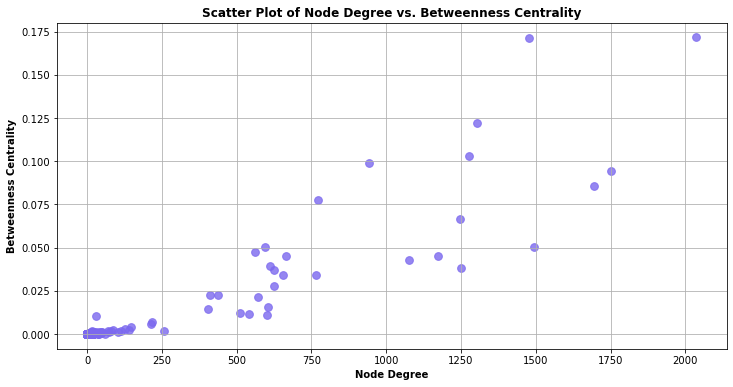

In [33]:
# Plot Scatterplot of Degree versus Betweeness
x = measures_ppi['Degree']
y = measures_ppi['Betweeness']

plt.figure(figsize=(12, 6))
plt.scatter(x, y, color = 'mediumslateblue', alpha = 0.8, s = 60)

plt.title('Scatter Plot of Node Degree vs. Betweenness Centrality', fontweight = 'bold')
plt.xlabel('Node Degree', fontweight = 'bold')
plt.ylabel('Betweenness Centrality', fontweight = 'bold')
plt.grid()
plt.show()

This scatter plot suggests that proteins with a higher degree in the PPI network tend to also have higher betweenness centrality, indicating that these proteins are also central to the **network's connectivity and structure**.

#### 1.2.4) Globally Sparse, Locally Dense


The **density** of a graph is generally defined as the ratio of the number of edges with respect to the maximum possible edges.

In an undirected graph $G = (V, E)$:

$$
D = \frac{2 \cdot |E|}{|V| (|V| - 1)}
$$

Complex social networks are typically **globally sparse**, meaning that they have few edges compared to the number of potential connections. However, within these networks, connections are highly concentrated in **localized neighborhoods**.


Similarly, protein interactions are often sparse because not all proteins directly interact with one another. Instead, proteins tend to form modules, where each module represents a set of **related biological processes**.

In [34]:
# Compute Global Density
global_density = nx.density(LCC_ppi)
print(f'PPI Network Global Density: {global_density:.4f}')

# Compute Local Density
local_density = nx.average_clustering(LCC_ppi)
print(f'PPI Network Average Clustering Coefficient: {local_density:.4f}')

PPI Network Global Density: 0.0011
PPI Network Average Clustering Coefficient: 0.2907


#### 1.2.5) Small-World Network

Small-world networks show both **high clustering coefficients** and **short average path lengths**. This means that while nodes in the network are highly local interconnected, any two nodes originally far away can be reached through a relatively small number of steps, resulting in efficient communication within the network.

Small-worldness is commonly measured with the **small-world coefficient** *sigma* or omega. In this project, we use the first one:

$$
\text{sigma} = \frac{C / C_r}{ L / L_r}
$$

where

- $C$ is the average clustering coefficient of the graph of interest;
- $C_r$ is the average clustering coefficient of an equivalent random graph;
- $L$ is the average shortest path length of the graph of interest;
- $L_r$ is the average shortest path length of an equivalent random graph.

In [35]:
# Compute Average Path Lenght
avg_path_length = nx.average_shortest_path_length(LCC_ppi)
print(f'PPI Network Average Path Length: {avg_path_length:.4f}')

PPI Network Average Path Length: 2.8594


In [36]:
# Generate a random graph for comparison purpose
random_graph = nx.erdos_renyi_graph(n = LCC_ppi.number_of_nodes(), p = LCC_ppi.number_of_edges() / (LCC_ppi.number_of_nodes() ** 2))
local_density_random = nx.average_clustering(random_graph)
LCC_random = random_graph.subgraph(max(nx.connected_components(random_graph), key = len))
avg_path_length_random = nx.average_shortest_path_length(LCC_random)

# Compare clustering coefficients and average path lengths
clustering_ratio = local_density / local_density_random
path_length_ratio = avg_path_length / avg_path_length_random

In [37]:
print(f'Clustering Ratio: {clustering_ratio:.4f}')
print(f'Path Length Ratio: {path_length_ratio:.4f}')
print(f'Small-world-coefficient Sigma: {(clustering_ratio / path_length_ratio):.4f}')

Clustering Ratio: 1102.5698
Path Length Ratio: 0.4433
Small-world-coefficient Sigma: 2486.9970


Since *sigma* is much greater than $1$, we can state that this network definitely exhibits small-world properties.

### 1.3) Network visualization

#### 1.3.1) Gephi

As a first try, we loaded our dataset into the open-source platform [Gephi](https://gephi.org/) for graph visualization and exploration. We report below the PPI graph colored by degree, from lower (lighter green) to higher (darker green).

<div style = "text-align: center;">
    <img src = "./gephi_degree.png" alt = "Gephi Degree visualization" width = "850" />
</div>

A zoom into the nodes:

<div style = "text-align: center;">
    <img src = "./gephi_degree_1.png" alt = "Gephi Degree zoomed visualization" width = "850"/>
</div>


#### 1.3.2) Plotly

In [41]:
# Build graph
G = nx.Graph()

for idx, row in filtered_df.iterrows():
    G.add_edge(row['BioGRID ID Interactor A'], row['BioGRID ID Interactor B'])
    G.nodes[row['BioGRID ID Interactor A']]['Organism'] = row['Organism Name Interactor A']
    G.nodes[row['BioGRID ID Interactor B']]['Organism'] = row['Organism Name Interactor B']
    G.nodes[row['BioGRID ID Interactor A']]['Symbol'] = row['Official Symbol Interactor A']
    G.nodes[row['BioGRID ID Interactor B']]['Symbol'] = row['Official Symbol Interactor B']

for node in G.nodes():
    if node in measures_ppi['Protein'].values:
        centrality_measures = measures_ppi[measures_ppi['Protein'] == node]
        G.nodes[node]['Degree'] = round(centrality_measures['Degree'].iloc[0], 2)
        G.nodes[node]['Betweeness'] = round(centrality_measures['Betweeness'].iloc[0], 2)
        G.nodes[node]['Eigen'] = round(centrality_measures['Eigen'].iloc[0], 2)
        G.nodes[node]['BetoverDeg'] = round(centrality_measures['BetoverDeg'].iloc[0], 2)
    

# Remove self loops
self_loops = list(nx.selfloop_edges(G))
G.remove_edges_from(self_loops)

# Keep largest connected component
components = list(nx.connected_components(G))
largest_component = max(components, key = len)
G = G.subgraph(largest_component)
print(G)
print("\nExample node:")
print(list(G.nodes.data())[42])

Graph with 7116 nodes and 28960 edges

Example node:
(107843, {'Organism': 'Homo sapiens', 'Symbol': 'CSNK2B', 'Degree': 3, 'Betweeness': 0.0, 'Eigen': 0.0, 'BetoverDeg': 0.0})


In [42]:
# Colors and legend
color_map = {'Homo sapiens': '#7b68ee',
             'Severe acute respiratory syndrome coronavirus 2': '#ee7b68',
             'Severe acute respiratory syndrome-related coronavirus': '#68ee7b',
             'Middle-East Respiratory Syndrome-related Coronavirus': '#00ced1'}

node_colors = [color_map.get(G.nodes[node]['Organism'], '#ffffff')
               for node in G.nodes()]

colors_legend = [G.nodes[node]['Organism']
                 for node in G.nodes()]
#legend_labels = {organism: color for organism, color in color_map.items()}
legend_labels = {'Homo sapiens': '#7b68ee',
                'SARS-CoV-2': '#ee7b68',
                'SARS-CoV': '#68ee7b',
                'MERS-CoV': '#00ced1'}

# Plot the graph
fig = plot_3D_graph(G,
                    node_colors,
                    colors_legend,
                    legend_labels,
                    title = 'Covid-19 PPI Graph',
                    spread_factor = 5.0)

fig.show()

## 2) Community detection

We experimented with clustering algorithms for community detection based on the **disease module hypothesis**. This hypothesis assumes that topological communities tend to be involved in similar biological processes and that the disease phenotype can be described by their breakdown.

In this context, we compared the outcomes of three algorithms that align with this assumption:

- **Kwik Cluster (or Pivot) Algorithm**
- **Markov Clustering (MCL) Algorithm**
- **Louvain Algorithm**

To ensure that the identified clusters are neither too specific nor too general, we have established **minimum and maximum thresholds** (`100 <= len(cluster) <= 1000`) to strike the right balance for cluster size.
These thresholds have led to improved outcomes in the subsequent stages of community detection.

### 2.1) Kwik Cluster (or Pivot) Algorithm

The first technique we tried belongs to the category of *Correlation Clustering*. <br>
It is usually applied to signed networks, where the edges of a complete and unweighted graph are labeled as *positive* and *negative* edges. In our case, we can consider the graph as complete and the existing edges as positive, the non-existing edges as negative. This aligns with the formulation of the objective function of correlation clustering: maximizing agreement (sum of positive edge within a cluster plus the absolute value of the sum of negative edge between clusters) or minimizing disagreement (absolute value of the sum of negative edge within a cluster plus the sum of positive edge across clusters). <br>
So, for us:
- *presence* of an edge suggests that nodes should be clustered together;
- *absence* of an edge suggests that nodes should be assigned to different clusters.

KwikCluster (or Pivot) is a very simple and elegant algorithm to implement correlation clustering. Given a graph $G = (V, E)$, at each run the algorithm selects a random node (*pivot*) $\pi$ from $V$, queries the similarities between $\pi$ and every other node in $V$, and creates a cluster containing the pivot itself and all the points $u$ such that a, arbitrary similarity function $\sigma(\pi, u) = +1$. That means, for us, all the nodes connected to the pivot by a positive edge (i.e. its neighbours). Then KwikCluster recursively invokes itself on $V \setminus C$.

The traditional implementation is recursive, but we chose to write an iterative version for computational reasons.


In [43]:
def kwik_cluster(G):
  clusters = []
  nodes = set(G.nodes)

  while nodes:
    # Select a random pivot
    pivot = random.choice(list(nodes))

    # Initialize the cluster with that pivot
    C = [pivot]

    # Remove the pivot from the remaining nodes
    nodes.remove(pivot)

    # Find all neighbors of the pivot
    for neighbor in list(nodes):
      if G.has_edge(pivot, neighbor):
        C.append(neighbor)
        # Remove the neighbor from remaining nodes
        nodes.remove(neighbor)

    # Add the cluster C to the list of clusters
    clusters.append(C)

  return clusters

In [44]:
# Compute KWIK clusters
KWIK_clusters = kwik_cluster(LCC_ppi)
print("Number of KWIK clusters: ", len(KWIK_clusters))

Number of KWIK clusters:  6961


In [45]:
# Select communities with a number of nodes between 100 and 1000
KWIK_clusters_filtered = [cluster for cluster in KWIK_clusters if 100 <= len(cluster) <= 1000]
print("Number of filtered KWIK clusters: ", len(KWIK_clusters_filtered))

Number of filtered KWIK clusters:  0


The KwikCluster algorithm gives us quite poor results: the clusters identified are numerous and too specific, making them unsuitable for identifying biological processes. This is disappointing, but thinking about it we can expect it to happen: in fact, being our graph globally sparse with almost all of its nodes having degree equal to $1$, there's a really high probability that choosing a pivot uniformly at random the algorithm will miss the few nodes that act as "hubs". On the other hand, it's much easier that one of their neighbours will be chosen as pivot and incorporate the "hub" in its cluster, leaving the rest of its neighbourhood as singletons.

### 2.2) Markov Cluster Algorithm

The Markov Clustering (MCL) algorithm detects clusters by simulating **random flow** through a graph.  It essentially performs matrix multiplication on the adjacency matrix of the graph to propagate the flow between nodes.

In [46]:
# Convert the LCC_ppi network to a suitable format for MCL algorithm
matrix = nx.to_scipy_sparse_array(LCC_ppi)
matrix = csr_matrix(matrix)
matrix.shape

(7116, 7116)

The **inflation parameter** controls the granularity of clustering:

- The inflation parameter strengthens strong nodes, and weakens already weak nodes;

- By Increasing the inflation parameter, increases the tendency to form smaller and more distinct clusters, resulting in a greater number of clusters;

- By decreasing the inflation parameter, increases the tendency to form larger and more general clusters, resulsing in fewer clusters as the algorithm becomes less aggressive in clustering.

The **expansion parameter** maintains also the farther nodes still reachable:

- The expansion operator is responsible for allowing flow to connect different regions of the graph;

- The expansion operator specifies the power of the Markov Chain transition matrix.

In [47]:
# Run the MCL algorithm with inflaction = 1.8
result = mc.run_mcl(matrix, inflation = 1.8)
MCL_clusters = mc.get_clusters(result)
print("Number of MCL clusters: ", len(MCL_clusters))

Number of MCL clusters:  46


In [48]:
# Select communities with a number of nodes between 100 and 1000
MCL_clusters_filtered = [cluster for cluster in MCL_clusters if 100 <= len(cluster) <= 1000]
print("Number of filtered MCL clusters: ", len(MCL_clusters_filtered))

Number of filtered MCL clusters:  8


In [49]:
for i, cluster in enumerate(MCL_clusters_filtered):
  print(f"Number of proteins in MCL Cluster {i + 1}: {len(cluster)}")

Number of proteins in MCL Cluster 1: 594
Number of proteins in MCL Cluster 2: 106
Number of proteins in MCL Cluster 3: 338
Number of proteins in MCL Cluster 4: 374
Number of proteins in MCL Cluster 5: 108
Number of proteins in MCL Cluster 6: 170
Number of proteins in MCL Cluster 7: 109
Number of proteins in MCL Cluster 8: 174


In [50]:
# Map cluster index to protein id
nodes = np.array(LCC_ppi.nodes())
MCL_clusters_filtered_2 = []
for cluster in MCL_clusters_filtered:
  cluster_names = [nodes[index] for index in cluster]
  MCL_clusters_filtered_2.append(cluster_names)

In [51]:
# Visualize MCL communities

# Associate each node to its cluster label
MCL_node_to_cluster = {}
for cluster_id, cluster in enumerate(MCL_clusters_filtered_2):
    for node in cluster:
        MCL_node_to_cluster[node] = cluster_id

# Colors and legend
cluster_colors = ['#440154', '#482777', '#3e4a8c', '#31688e',
                  '#26828e', '#1f9e89', '#35b779', '#aadc32']
default_color = '#D3D3D3'
node_colors = [cluster_colors[MCL_node_to_cluster[node]] if node in MCL_node_to_cluster
               else default_color for node in G.nodes()]
colors_legend = [f"Cluster {MCL_node_to_cluster[node]}" if node in MCL_node_to_cluster
                 else "Unclustered" for node in G.nodes()]
legend_labels = {f"Cluster {i}": color for i, color in enumerate(cluster_colors)}
legend_labels['Unclustered'] = default_color

# Plot the graph
fig = plot_3D_graph(G,
                    node_colors,
                    colors_legend,
                    legend_labels,
                    title = 'Covid-19 PPI Graph - MCL Communities',
                    spread_factor = 5.0)

fig.show()

In [52]:
save_communities("MCL communities", MCL_clusters_filtered_2)

### 2.3) Louvain Algorithm

This technique is founded on the core concept of **modularity**: this notion measures the strength of division of a network into modules and is defined as the fraction of the edges that fall within the found communities minus the expected fraction if edges were distributed at random. The value of modularity for unweighted and undirected graphs lies in the range $[-0.5, 1]$. Biological networks typically exhibit a high degree of modularity.

Louvain algorithm optimizes modularity by iteratively merging nodes into communities to maximize the **modularity score**. Higher scores identify stronger communities. The two main steps of the algorithm are the following:

1. **Iterative Improvement**: initially, each node is assigned to its own community. Then, Louvain iterates through the nodes and computes the modularity gain by moving each node to its neighbouring communities;

2. **Community Aggregation**: after evaluating all nodes, the algorithm aggregates the nodes into the newly determined communities that have the maximum modularity gain.

The two steps are repeated until no further improvement in modularity can be achieved.

The **resolution parameter** adjusts the scale of the communities detected:

- By increasing the sensitivity to modularity variations, the algorithm tends to identify smaller and more numerous communities.

- By decreasing the sensitivity to modularity variations, the algorithm tends to identify larger and fewer communities.

In [53]:
# Run the Louvain algorithm with gamma = 1.0
louvain_communities = nx.community.louvain_communities(LCC_ppi, weight = 'weight', resolution = 1.0, seed = 42)
print("Number of Louvain communities: ", len(louvain_communities))

Number of Louvain communities:  10


In [54]:
# Select communities with a number of nodes between 100 and 1000
louvain_communities_filtered = [community for community in louvain_communities if 100 <= len(community) <= 1000]
print("Number of filtered Louvain communities: ", len(louvain_communities_filtered))

Number of filtered Louvain communities:  9


In [55]:
for i, community in enumerate(louvain_communities_filtered):
  print(f"Number of proteins in Louvain Community {i + 1}: {len(community)}")

Number of proteins in Louvain Community 1: 690
Number of proteins in Louvain Community 2: 687
Number of proteins in Louvain Community 3: 931
Number of proteins in Louvain Community 4: 509
Number of proteins in Louvain Community 5: 543
Number of proteins in Louvain Community 6: 402
Number of proteins in Louvain Community 7: 367
Number of proteins in Louvain Community 8: 360
Number of proteins in Louvain Community 9: 891


In [56]:
# Visualize Louvain communities

# Associate each node to its cluster label
louvain_node_to_cluster = {}
for cluster_id, cluster in enumerate(louvain_communities_filtered):
    for node in cluster:
        louvain_node_to_cluster[node] = cluster_id

# Colors and legend
cluster_colors = ['#440154', '#482777', '#3e4a8c', '#31688e', '#26828e', 
                  '#1f9e89', '#35b779', '#6ace5b', '#aadc32', '#fde725']
default_color = '#D3D3D3'
node_colors = [cluster_colors[louvain_node_to_cluster[node]] if node in louvain_node_to_cluster
               else default_color for node in G.nodes()]
colors_legend = [f"Cluster {louvain_node_to_cluster[node]}" if node in louvain_node_to_cluster
                 else "Unclustered" for node in G.nodes()]
legend_labels = {f"Cluster {i}": color for i, color in enumerate(cluster_colors)}
legend_labels['Unclustered'] = default_color

# Plot the graph
fig = plot_3D_graph(G,
                    node_colors,
                    colors_legend,
                    legend_labels,
                    title = 'Covid-19 PPI Graph - Louvain Communities',
                    spread_factor = 5.0)

fig.show()

In [57]:
save_communities("louvain communities", louvain_communities_filtered)

### 2.4) Communities interpretation

In order to obtain more reliable communities and check the consistency of the various algorithms, we inspect the intersection of the computed Markov clusters and Louvain communities.

In [58]:
overlap_info = {}

for i, louvain_community in enumerate(louvain_communities_filtered):
  louvain_community_proteins = set(louvain_community)
  max_overlap_count = 0
  max_overlap_cluster = None
  proteins_in_common = set()

  for j, mcl_cluster in enumerate(MCL_clusters_filtered_2):
    mcl_cluster_proteins = set(mcl_cluster)

    # Compute the overlap using intersection
    overlap_set = louvain_community_proteins.intersection(mcl_cluster_proteins)
    overlap_count = len(overlap_set)

    # Save the maximum overlap
    if overlap_count > max_overlap_count:
      max_overlap_count = overlap_count
      max_overlap_cluster = j
      proteins_in_common = overlap_set

  # Save the info in the dictionary
  overlap_info[i] = {
      'mcl_cluster': max_overlap_cluster + 1,
      'overlap_count': max_overlap_count,
      'proteins_in_common': list(proteins_in_common)
  }

  print(f"Louvain Community {i + 1} has the most overlap with MCL Cluster {max_overlap_cluster + 1} with {max_overlap_count} proteins in common.")

Louvain Community 1 has the most overlap with MCL Cluster 6 with 114 proteins in common.
Louvain Community 2 has the most overlap with MCL Cluster 1 with 371 proteins in common.
Louvain Community 3 has the most overlap with MCL Cluster 1 with 28 proteins in common.
Louvain Community 4 has the most overlap with MCL Cluster 3 with 256 proteins in common.
Louvain Community 5 has the most overlap with MCL Cluster 8 with 136 proteins in common.
Louvain Community 6 has the most overlap with MCL Cluster 1 with 27 proteins in common.
Louvain Community 7 has the most overlap with MCL Cluster 3 with 10 proteins in common.
Louvain Community 8 has the most overlap with MCL Cluster 3 with 8 proteins in common.
Louvain Community 9 has the most overlap with MCL Cluster 4 with 261 proteins in common.


The overlaps between Louvain communities and MCL clusters provide insights into the consistency of the two algorithms:
- **High overlap** could indicate that both algorithms are capturing *similar patterns* within the network;
- **Low overlap** might suggest that either the community is not relevant, or each algorithm is revealing *different aspects* of the network’s structure.

Clearly, this method does not guarantee us disjointed intersections between Markov clusters and Louvain communities, as the two methods return different groups of nodes. Therefore, we proceed to an enrichment analysis to combine the results of the two algorithms based on the biological processes in which the communities are involved.

#### 2.4.1) Enrichment analysis Markov Cluster

To understand the functions of proteins at a biological and molecular level, we performed an enrichment analysis. **Gene set enrichment analysis (GSEA)** is a method to identify classes of genes or proteins that are over-represented in a large set of genes or proteins and may have an association with different phenotypes [[⁷]](https://en.wikipedia.org/wiki/Gene_set_enrichment_analysis) [[⁸]](https://geneontology.org/docs/go-enrichment-analysis/).

For this analysis, we used the **GO Biological Processes** database, which helps us understand the general biological processes that the genes are involved in.

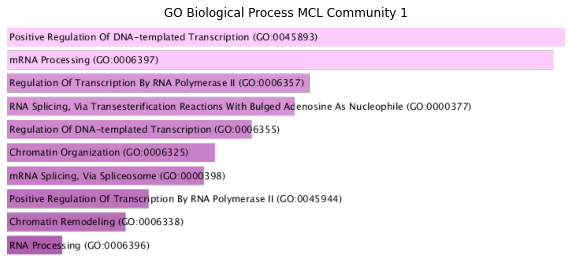

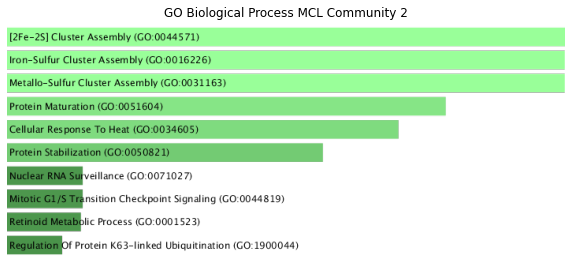

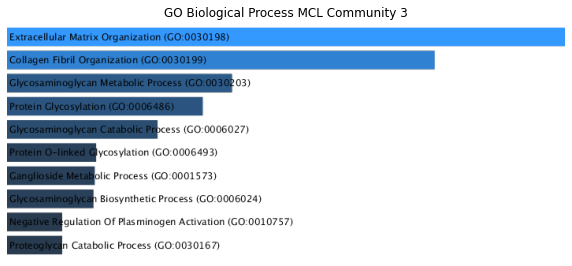

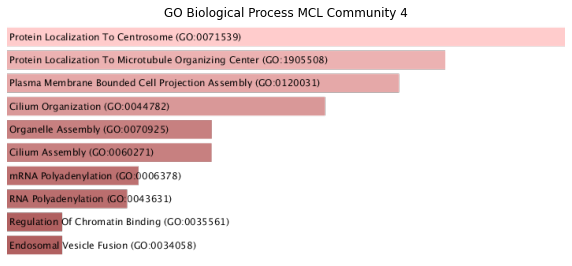

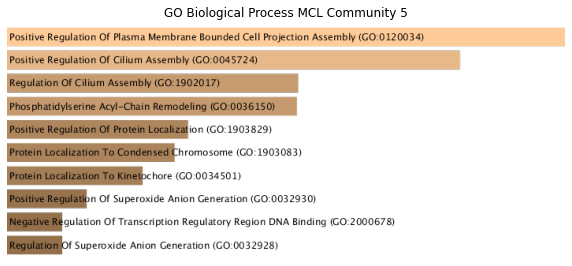

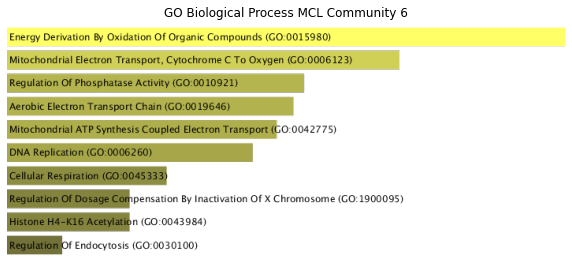

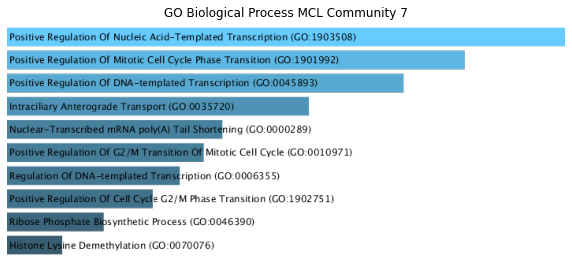

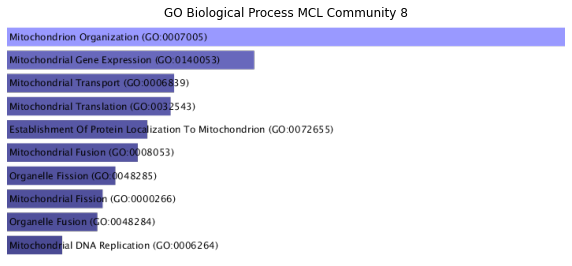

In [62]:
# MCL GO Biological Processes
display_biological_process('MCL', 'MCL_BP')

#### 2.4.2) Enrichment analysis Louvain 

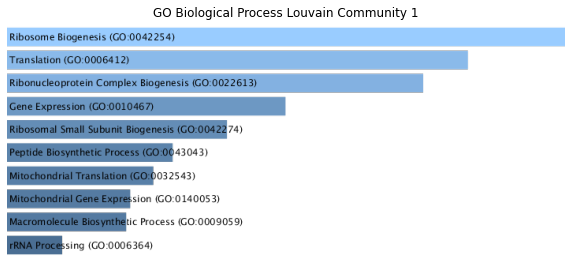

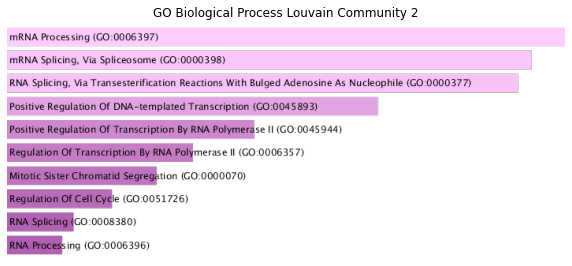

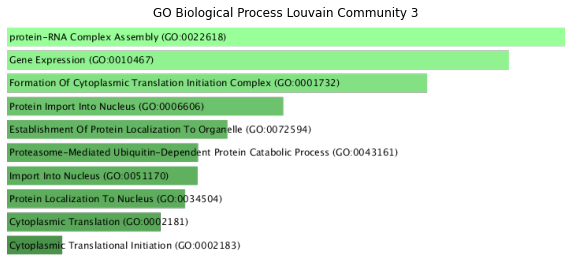

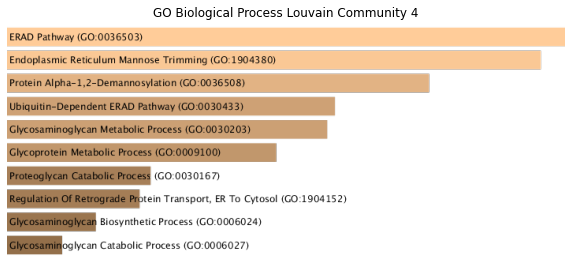

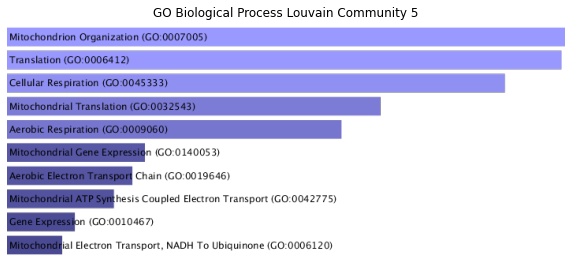

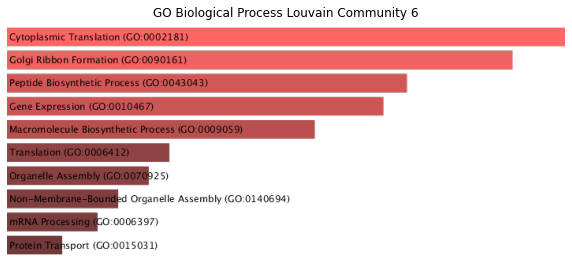

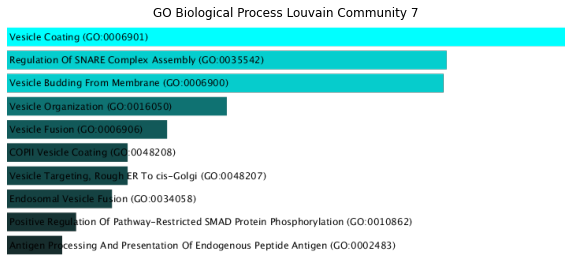

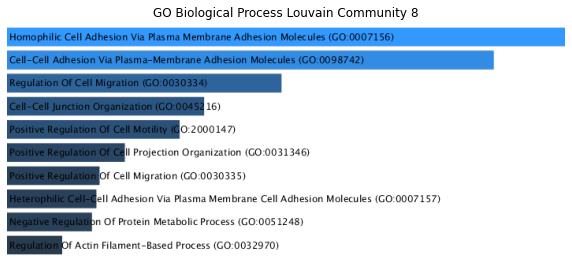

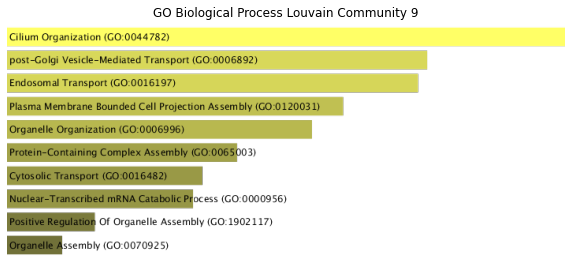

In [63]:
# Louvain GO Biological Processes
display_biological_process('Louvain', 'louvain_BP')

Louvain Community 2 and MCL Community 1 identified the same biological process (**mRNA Processing**), as well as Louvain Community 5 and MCL Community 8 (**Mitochondrial Organization**). The differences observed in the biological processes among other communities can be attributed to the different implementations of the two clustering algorithms, revealing different aspects of the network’s structure.

Examining these biological processes is crucial for understanding how COVID-19 interacts with host cells and how these mechanisms can influence **disease progression and therapeutic response**.


## 3) Link Prediction with Graph Neural Networks (GNNs)

Graph Neural Networks (GNNs) are models that belong to the area of **Geometric Deep Learning**.

Unlike traditional deep learning models, that process specific types of data (images, videos, audio signals, etc.), GNNs are specifically designed to work on data that is inherently non-Euclidean and to capture the information contained not only in the input features, but also and especially in its *structure*. This apparently small difference has drastic consequences, because as long as data lies in Euclidean space, operations like convolution and their properties are well defined, but graph-structured data introduce the need for a whole different mathematical formulation.

Graphs lack a fixed structure. So, GNNs try to learn from a node's neighborhood. The aggregation of information thus gathered, conveyed by *message-passing mechanisms*, is key to learning representations that capture both structure and features. In our case, the features that will be encoded in the input data object include the centrality measures, the type of organism and the functional role of each node. Hopefully, this will help the models identifying central nodes and interactions types. 

### 3.1) Utility functions

In [64]:
def nx_to_pyg_data(G, centrality_dict):
    '''
    Utility function to convert NetworkX graph in PyTorch Data object, including centrality measures.
    '''
    
    # Extracting degree information
    degrees = [G.degree(node) for node in G.nodes]
    degrees = torch.tensor(degrees, dtype = torch.float).view(-1, 1)

    # Extracting organism and symbol information and encoding
    organisms = [G.nodes[node]['Organism'] for node in G.nodes]
    symbols = [G.nodes[node]['Symbol'] for node in G.nodes]
    organism_encoder = LabelEncoder()
    symbol_encoder = LabelEncoder()
    encoded_organisms = torch.tensor(organism_encoder.fit_transform(organisms), dtype=torch.long).view(-1, 1)
    encoded_symbols = torch.tensor(symbol_encoder.fit_transform(symbols), dtype=torch.long).view(-1, 1)
    organism_onehot = F.one_hot(encoded_organisms.squeeze(), num_classes=len(organism_encoder.classes_)).float()
    symbol_onehot = F.one_hot(encoded_symbols.squeeze(), num_classes=len(symbol_encoder.classes_)).float()

    # Put degree, organism, and symbol into a single feature matrix
    node_features = torch.cat([degrees, organism_onehot, symbol_onehot], dim = -1)

    # Extract centrality measures for all nodes
    betweenness = []
    eigenvector = []
    betweenness_over_degree = []

    for node in G.nodes:
        centrality_metrics = centrality_dict.get(node, None)
        if centrality_metrics is not None:
            betweenness.append(centrality_metrics['Betweeness'])
            eigenvector.append(centrality_metrics['Eigen'])
            betweenness_over_degree.append(centrality_metrics['BetoverDeg'])
        else:
            betweenness.append(0.0)
            eigenvector.append(0.0)
            betweenness_over_degree.append(0.0)

    # Cast to tensors
    betweenness = torch.tensor(betweenness, dtype=torch.float).view(-1, 1)
    eigenvector = torch.tensor(eigenvector, dtype=torch.float).view(-1, 1)
    betweenness_over_degree = torch.tensor(betweenness_over_degree, dtype=torch.float).view(-1, 1)

    # Add centrality measures to the node features
    centrality_features = torch.cat([betweenness, eigenvector, betweenness_over_degree], dim=-1)
    node_features = torch.cat([node_features, centrality_features], dim=-1)

    # Create PyTorch Geometric data object
    data = from_networkx(G)
    data.x = node_features 

    return data



def plot_loss_acc_link_plotly(train_lss_curve, val_lss_curve, model_name, save = False):
    '''
    Utility function to plot Loss and AUC of the model training and validation.
    '''
    
    fig = go.Figure()

    # Training loss curve
    fig.add_trace(go.Scatter(
        x=list(range(len(train_lss_curve))),
        y=train_lss_curve,
        mode='lines',
        name='Train Loss',
        line=dict(color='mediumslateblue', width=2)
    ))

    # Validation Loss curve
    fig.add_trace(go.Scatter(
        x=list(range(len(val_lss_curve))),
        y=val_lss_curve,
        mode='lines',
        name='Validation Loss',
        line=dict(color='#ee7b68', width=2)
    ))

    # Layout details
    fig.update_layout(
        title=f"{model_name}: Training Loss and Validation Loss",
        xaxis_title='epochs',
        yaxis_title='loss',
        legend=dict(yanchor="top", y=0.99, xanchor="right", x=0.99),
        font=dict(size=14),
        width=900,
        height=500
    )

    if save:
        fig.write_image(f'curves_{model_name}.png')

    fig.show()


### 3.2) Training and evaluation setup

In [65]:
@no_grad()
def compute_metrics(model, criterion, data, k=10):
    '''
    Function that computes the validation loss and main performance metrics.
    '''

    model.eval()
    z = model.encode(data.x, data.edge_index)
    logits = model.decode(z, data.edge_label_index).view(-1)
    out = logits.sigmoid().cpu().numpy()

    edge_label = data.edge_label.cpu().numpy()

    # Loss
    loss = criterion(logits, data.edge_label.float()).item()
    # AUC-ROC
    auc_roc = roc_auc_score(edge_label, out)
    fpr, tpr, thresholds = roc_curve(edge_label, out)
    # F1-score
    preds = (out > 0.5).astype(int)
    f1 = f1_score(edge_label, preds)
    # Mean Reciprocal Rank (MRR)
    mrr_metric = RetrievalMRR()
    indexes = np.arange(len(edge_label))
    mrr = mrr_metric(torch.tensor(out), torch.tensor(edge_label), torch.tensor(indexes, dtype=torch.long)).item()
    # Hits@K
    hits_at_k_metric = RetrievalHitRate(top_k = k)
    hits_at_k = hits_at_k_metric(torch.tensor(out), torch.tensor(edge_label), torch.tensor(indexes, dtype=torch.long)).item()

    return {'loss' : loss,
            'auc_roc': auc_roc,
            'f1': f1,
            'mrr': mrr,
            'hits@k': hits_at_k,
            'roc_curve': [fpr, tpr, thresholds]}



# Train the link predictor
def train_link_predictor_1(model, train_data, val_data, optimizer, criterion, n_epochs = 10,  k = 10, patience = 7):
    '''
    Function that implements the training loop and optimization based on the loss function.
    '''
    
    train_lss_curve = []
    val_auc_curve = []
    val_loss, val_f1, val_auc, val_mrr, val_hits_at_k = [], [], [], [], []

    best_val_loss = float('inf')
    patience_counter = 0

    for epoch in range(1, n_epochs + 1):
        model.train()
        optimizer.zero_grad()

        z = model.encode(train_data.x, train_data.edge_index)

        # Negative sampling for missing edges
        neg_edge_index = negative_sampling (
            edge_index = train_data.edge_index,
            num_nodes = train_data.num_nodes,
            num_neg_samples = train_data.edge_label_index.size(1),
            method = 'sparse'
        )

        # Combine positive and negative edges
        edge_label_index = torch.cat([train_data.edge_label_index, neg_edge_index], dim=-1)
        edge_label = torch.cat([train_data.edge_label, train_data.edge_label.new_zeros(neg_edge_index.size(1))], dim = 0)

        out = model.decode(z, edge_label_index).view(-1)
        loss = criterion(out, edge_label)
        train_lss_curve.append(loss.item())

        loss.backward()
        optimizer.step()

        # Validation Loss and metrics
        val_metrics = compute_metrics(model, criterion, val_data, k)
        val_loss.append(val_metrics['loss'])
        val_auc.append(val_metrics['auc_roc'])
        val_f1.append(val_metrics['f1'])
        val_mrr.append(val_metrics['mrr'])
        val_hits_at_k.append(val_metrics['hits@k'])

        # Validation AUC
        val_auc_value = eval_link_predictor(model, val_data)
        val_auc_curve.append(val_auc_value)

        # EARLY STOPPPING condition
        if val_metrics['loss'] < best_val_loss:
            best_val_loss = val_metrics['loss']
            patience_counter = 0    # reset counter
        else:
            patience_counter += 1   # increase counter

        if patience_counter >= patience:
            print(f"[Early stopping at epoch {epoch} due to no improvement in validation loss.]")
            break

        #if epoch % 5 == 0:
        print('-' * 73)
        print(f"| End of Epoch {epoch:3d} | Train Loss {loss:.3f} | Val Loss {val_metrics['loss']:.3f} | Val AUC: {val_auc_value:.3f} |")
        print('-' * 73)

    return model, train_lss_curve, val_auc_curve, val_loss



@torch.no_grad()
def eval_link_predictor(model, data):
    model.eval()
    z = model.encode(data.x, data.edge_index)
    out = model.decode(z, data.edge_label_index).view(-1).sigmoid()
    return roc_auc_score(data.edge_label.cpu().numpy(), out.cpu().numpy())

### 3.3) Split the data

The training, validation and test set are created using the function `RandomLinkSplit` from the package `torch_geometric`: it performs an edge-level random split of the graph Data object. The split is performed such that the various sets do not contain common edges. The parameters to determine the split size are:
- `num_val`: the ratio of edges to include in the validation set over the total edges;
- `num_test`: the ratio of edges to include in the test set over the total edges;

In [66]:
data = nx_to_pyg_data(G, protein_measures)

split = RandomLinkSplit(
    num_val = 0.2,
    num_test = 0.2,
    is_undirected = True,
    add_negative_train_samples = False,
    neg_sampling_ratio = 1.0
)

train_data, val_data, test_data = split(data)

print("Training data:")
print(train_data)
print("\nValidation data:")
print(val_data)
print("\nTest data:")
print(test_data)

Training data:
Data(edge_index=[2, 34752], Organism=[7116], Symbol=[7116], Degree=[7116], Betweeness=[7116], Eigen=[7116], BetoverDeg=[7116], num_nodes=7116, x=[7116, 7095], edge_label=[17376], edge_label_index=[2, 17376])

Validation data:
Data(edge_index=[2, 34752], Organism=[7116], Symbol=[7116], Degree=[7116], Betweeness=[7116], Eigen=[7116], BetoverDeg=[7116], num_nodes=7116, x=[7116, 7095], edge_label=[11584], edge_label_index=[2, 11584])

Test data:
Data(edge_index=[2, 46336], Organism=[7116], Symbol=[7116], Degree=[7116], Betweeness=[7116], Eigen=[7116], BetoverDeg=[7116], num_nodes=7116, x=[7116, 7095], edge_label=[11584], edge_label_index=[2, 11584])


As we can see, the training set contains $17376$ edges, the validation set $11584$ edges ($20\%$ of the total), the test set $11584$ edges ($20\%$ of the total).

 ### 3.4) Models

The task that we address in this project is Link Prediction. It consists in predicting existing/non-existing edges between nodes in a graph. In the context of biological networks, and especially PPI networks, developing strong link prediction models is very important to help identifying potential functional interactions between proteins or other agents that may not be observed yet. Accurate predictions can be used in discovering new biological pathways, identifying drug targets, and understanding diseases, with potentially great impacts in research.

We propose $4$ different models to perform the same Link Prediction task. They are presented in an increasing order of structural complexity, and their performances will be later evaluated and summarized to allow for an easy comparison. 

We experimented with the main types of layers for Graph Neural Networks:

- **Graph Convolutional Networks (GCNconv)**: they perform a weighted aggregation of neighboring nodes information and capture local structural features by propagating between nodes in the graph;
- **Graph Attention Networks (GATconv)**: they build upon GCNs by including an attention mechanism, which allows the network to weigh differently the importance of neighbour nodes. This helps the model focus more on relevant connections while ignoring less important ones;
- **Graph SAGE Network (SAGEconv)**: SAmple and aggreGatE. These layer samples and aggregates features from a fixed-size set of neighbour nodes, instead of using all of them (like GCNs). This allows GraphSAGE to generalize well even to dynamic graphs.

1. **First model**: a simple GNN with just one Graph Convolutional layer.

In [67]:
# A simple GNN model
class SimplestGNN(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.gcn = GCNConv(in_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.gcn(x, edge_index)
        return x

    def decode(self, z, edge_label_index):
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=-1)

    def decode_all(self, z):
        prob_adj = z @ z.t()
        return (prob_adj > 0).nonzero(as_tuple=False).t()

2. **Second model**: we add a layer to see if there's a noteworthy difference just with this basic change. This model will be the baseline for our results.

In [68]:
# Adding a layer
class Baseline(nn.Module):
	def __init__(self, in_channels, hidden_channels, out_channels):
		super().__init__()
		self.conv1 = GCNConv(in_channels, hidden_channels)
		self.conv2 = GCNConv(hidden_channels, out_channels)

	def encode(self, x, edge_index):
			x = self.conv1(x, edge_index).relu()
			x = self.conv2(x, edge_index)
			return x

	def decode(self, z, edge_label_index):
		return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=-1)

	def decode_all(self, z):
		prob_adj = z @ z.t()
		return (prob_adj > 0).nonzero(as_tuple=False).t()

3. **Third model**: we increase the complexity a bit more, creating a small deep GNN with four convolutional layers.

In [69]:
# Increasing the architecture depth
class DeepGNN(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.conv3 = GCNConv(hidden_channels, hidden_channels)
        self.conv4 = GCNConv(hidden_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.conv1(x, edge_index).relu()
        x = self.conv2(x, edge_index).relu()
        x = self.conv3(x, edge_index).relu()
        x = self.conv4(x, edge_index)
        return x

    def decode(self, z, edge_label_index):
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=-1)

    def decode_all(self, z):
        prob_adj = z @ z.t()
        return (prob_adj > 0).nonzero(as_tuple=False).t()

4. **Fourth model**: finally, we try a GNN with a deeper architecture and mixing different types of layers.

In [70]:
# Mixing types of layers
class MixedGNN(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, num_heads=8):
        super().__init__()
        self.gcn1 = GCNConv(in_channels, hidden_channels)
        self.gat = GATConv(hidden_channels, hidden_channels // num_heads, heads=num_heads, concat=True)
        self.linear_proj = nn.Linear(hidden_channels, hidden_channels)
        self.sage = SAGEConv(hidden_channels, hidden_channels)
        self.gcn2 = GCNConv(hidden_channels, out_channels)

    def encode(self, x, edge_index):
        x = self.gcn1(x, edge_index).relu()
        x = self.gat(x, edge_index).relu()
        x = self.linear_proj(x).relu()
        x = self.sage(x, edge_index).relu()
        x = self.gcn2(x, edge_index)
        return x

    def decode(self, z, edge_label_index):
        return (z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=-1)

    def decode_all(self, z):
        prob_adj = z @ z.t()
        return (prob_adj > 0).nonzero(as_tuple=False).t()

### 3.5) Training

In [71]:
# Hyperparameter setup
lr = 0.005
wd = 5e-4
n_epochs = 30
hidden_channels = 128
out_channels = 64
num_heads = 8

1. **First model**

In [72]:
# 1
simplest_model = SimplestGNN(train_data.num_features, out_channels,).to(device)    # GNN model
optimizer = Adam(simplest_model.parameters(), lr = lr, weight_decay = wd)          # optimizer
criterion = nn.BCEWithLogitsLoss()                                                 # loss function

train_data, val_data, test_data = train_data.to(device), val_data.to(device), test_data.to(device)

# Training and validation
simplest_model, train_lss_curve_simplest, val_auc_curve_simplest, val_lss_curve_simplest = train_link_predictor_1(simplest_model, train_data, val_data, optimizer, criterion, n_epochs)

# AUC on the test set
test_auc_simplest = eval_link_predictor(simplest_model, test_data)
print(f"\nTest AUC: {test_auc_simplest:.3f}")

-------------------------------------------------------------------------
| End of Epoch   1 | Train Loss 16.845 | Val Loss 9.297 | Val AUC: 0.691 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   2 | Train Loss 9.345 | Val Loss 4.647 | Val AUC: 0.734 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   3 | Train Loss 4.552 | Val Loss 2.264 | Val AUC: 0.749 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   4 | Train Loss 2.233 | Val Loss 1.369 | Val AUC: 0.811 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   5 | Train Loss 1.346

In [73]:
plot_loss_acc_link_plotly(train_lss_curve_simplest, val_lss_curve_simplest, 'SimplestGNN')

print('-----------------------\n')
simplest_total_params = sum(p.numel() for p in simplest_model.parameters() if p.requires_grad)
print(f'Total number of parameters: {simplest_total_params}')

-----------------------

Total number of parameters: 454144


2. **Second model**

In [74]:
# 2
base_model = Baseline(train_data.num_features, hidden_channels, out_channels).to(device)    # GNN model
optimizer = torch.optim.Adam(params = base_model.parameters(), lr = lr, weight_decay = wd)  # optimizer
criterion = nn.BCEWithLogitsLoss()                                                          # loss function

# Training and validation
base_model, train_loss_base, val_auc_base, val_loss_base = train_link_predictor_1(base_model, train_data, val_data, optimizer, criterion, n_epochs, 10)

# AUC on the test set
test_auc_base = eval_link_predictor(base_model, test_data)
print(f"\nTest AUC: {test_auc_base:.3f}")

-------------------------------------------------------------------------
| End of Epoch   1 | Train Loss 2.288 | Val Loss 0.707 | Val AUC: 0.958 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   2 | Train Loss 0.694 | Val Loss 0.515 | Val AUC: 0.991 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   3 | Train Loss 0.510 | Val Loss 0.528 | Val AUC: 0.994 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   4 | Train Loss 0.543 | Val Loss 0.512 | Val AUC: 0.994 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   5 | Train Loss 0.552 

In [75]:
plot_loss_acc_link_plotly(train_loss_base, val_loss_base, 'Baseline')

print('-----------------------\n')
base_total_params = sum(p.numel() for p in base_model.parameters() if p.requires_grad)
print(f'Total number of parameters: {base_total_params}')

-----------------------

Total number of parameters: 916544


3. **Third model**

In [76]:
# 3
link_model_1 = DeepGNN(train_data.num_features, hidden_channels, out_channels).to(device)    # GNN model
optimizer = Adam(link_model_1.parameters(), lr = lr, weight_decay = wd)                      # optimizer
criterion = nn.BCEWithLogitsLoss()                                                           # loss function

train_data, val_data, test_data = train_data.to(device), val_data.to(device), test_data.to(device)

# Training and validation
link_model_1, train_lss_curve_1, val_auc_curve_1, val_lss_curve_1 = train_link_predictor_1(link_model_1, train_data, val_data, optimizer, criterion, n_epochs)

# AUC on the test set
test_auc_1 = eval_link_predictor(link_model_1, test_data)
print(f"\nTest AUC: {test_auc_1:.3f}")

-------------------------------------------------------------------------
| End of Epoch   1 | Train Loss 0.811 | Val Loss 0.478 | Val AUC: 0.967 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   2 | Train Loss 0.451 | Val Loss 0.445 | Val AUC: 0.991 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   3 | Train Loss 0.415 | Val Loss 0.474 | Val AUC: 0.992 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   4 | Train Loss 0.466 | Val Loss 0.441 | Val AUC: 0.991 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   5 | Train Loss 0.413 

In [77]:
plot_loss_acc_link_plotly(train_lss_curve_1, val_lss_curve_1, 'DeepGNN')

print('-----------------------\n')
link1_total_params = sum(p.numel() for p in link_model_1.parameters() if p.requires_grad)
print(f'Total number of parameters: {link1_total_params}')

-----------------------

Total number of parameters: 949568


4. **Fourth model**

In [78]:
# 4
link_model_2 = MixedGNN(train_data.num_features, hidden_channels, out_channels, num_heads).to(device)    # GNN model
optimizer = Adam(link_model_2.parameters(), lr = lr, weight_decay = wd)                                  # optimizer                                  
criterion = nn.BCEWithLogitsLoss()                                                                       # loss function

train_data, val_data, test_data = train_data.to(device), val_data.to(device), test_data.to(device)

# Training and validation
link_model_2, train_lss_curve_2, val_auc_curve_2, val_lss_curve_2 = train_link_predictor_1(link_model_2, train_data, val_data, optimizer, criterion, n_epochs)

# AUC on the test set
test_auc_2 = eval_link_predictor(link_model_2, test_data)
print(f"\nTest AUC: {test_auc_2:.3f}")

-------------------------------------------------------------------------
| End of Epoch   1 | Train Loss 0.441 | Val Loss 0.444 | Val AUC: 0.993 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   2 | Train Loss 0.437 | Val Loss 0.613 | Val AUC: 0.996 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   3 | Train Loss 0.609 | Val Loss 0.447 | Val AUC: 0.993 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   4 | Train Loss 0.439 | Val Loss 0.454 | Val AUC: 0.991 |
-------------------------------------------------------------------------
-------------------------------------------------------------------------
| End of Epoch   5 | Train Loss 0.440 

In [79]:
plot_loss_acc_link_plotly(train_lss_curve_2, val_lss_curve_2, 'MixedGNN')

print('-----------------------\n')
link2_total_params = sum(p.numel() for p in link_model_2.parameters() if p.requires_grad)
print(f'Total number of parameters: {link2_total_params}')

-----------------------

Total number of parameters: 982720


### 3.6) Evaluation of results

In the context of link prediction tasks, we need to be careful when using accuracy as a performance metric: as a matter of fact, accuracy can be highly influenced by how negative test examples are selected in the graph. If, by any chance, no negative examples are included in the test set, a model may achieve perfect accuracy by simply predicting always a positive outcome, which is actually a not desirable behaviour. The risk is to not understand the actual predictive capabilities of the model. Therefore, we choose to adopt some other evaluation measures that are more informative for our purposes.

These metrics are:

- **Area Under The Curve (AUC)**: it represents the area under the Receiver Operating Characteristic (ROC) curve and reflects the model's ability to distinguish between positive and negative examples across different classification thresholds. Its values range from $0$ (model that predicts exactly the contrary of what it should) to $1$ (perfect model). The worst value is $0.5$, indicating no better performance than random guessing.

- **F1-score**: it is defined as $F1 = \frac{2 \,\cdot\, precision \,\cdot\, recall}{precision \, + \, recall}$, i.e. the harmonic mean of precision and recall. It is a particularly useful metric when dealing with imbalanced datasets and ranges from $0$ to $1$, with higher values indicating better performance.

- **Mean Reciprocal Rank (MRR)**: it measures the effectiveness of a ranking model by averaging the reciprocal of the rank at which the first relevant (positive) result appears for each query. MRR values range from $0$ to $1$, where a higher value indicates that relevant items tend to appear earlier in the ranking. Higher values indicate that the model puts more correct edge predictions at the higher place in the ranking. Not only focuses on the models' correct predictions but also on the prediction "strength".

- **Hits@K**: this metric calculates the proportion of true edges that appear within the top-K predictions for a given node. Hits@K values range from $0$ to $1$, where a higher value means that the model is more likely to place positive predictions within the top-K ranked results. The position in the ranking doesn't matter, in contrast to MRR.


Additionally, we track the final validation loss at the end of the training phase, as well as the total number of parameters in each model. Since all models aim to minimize the same loss function, the validation loss provides insights into the model's learning process. Together with the parameter count, it offers a sense of model complexity and performance balance.

In [80]:
def metrics_report(models_list, names_list, params_list, val_lss_list, criterion, test_data, k):
    '''
    Utility function to loop over list of models and print a report of their performance metrics.
    '''

    metrics_summary = []

    for i, model in enumerate(models_list):
    
        metrics = compute_metrics(model, criterion, test_data, k)
        test_metrics = {
            'Model': names_list[i],
            'AUC': round(metrics['auc_roc'], 4),
            'F1': round(metrics['f1'], 4),
            'MRR': round(metrics['mrr'], 4),
            f'Hits@{k}': metrics['hits@k'],
            'Val Loss': round(val_lss_list[i][-1], 4),
            'n. params': params_list[i]
        }
        metrics_summary.append(test_metrics)

    metrics_df = pd.DataFrame(metrics_summary)
    metrics_df.set_index('Model', inplace = True)
    metrics_df_sorted = metrics_df.sort_values(by = 'AUC', ascending = False)
    
    return metrics_df_sorted



def plot_roc_curves(models_list, names_list, k, save = False):
    '''
    Utility function to plot ROC curves and AUC scores for all models.
    '''

    fig, axs = plt.subplots(2, 2, figsize = (15, 10))
    fig.suptitle('ROC Curves and AUC scores\nfor all models', fontsize = 16)
    axs = axs.flatten()

    for i, model in enumerate(models_list):

        metrics = compute_metrics(model, criterion, test_data, k)

        fpr, tpr, tr = metrics['roc_curve']
        auc = metrics['auc_roc']

        axs[i].plot(fpr, tpr, color = 'mediumslateblue', lw = 2, label = 'ROC curve (AUC = %0.3f)' % auc)
        axs[i].plot([0, 1], [0, 1], color = 'gray', linestyle = '--')
        axs[i].set_xlim([0, 1])
        axs[i].set_ylim([0, 1])
        axs[i].set_xlabel('False Positive rate')
        axs[i].set_ylabel('True Positive rate')
        axs[i].set_title(f'{names_list[i]} ROC curve')
        axs[i].legend(loc = "lower right")

    plt.tight_layout(rect = [0, 0.03, 1, 0.95])

    if save:
        fig.write_image('ROC_curves.png')
        
    plt.show()


In [81]:
# Print evaluation metrics report
k = 10
models_list  = [simplest_model, base_model, link_model_1, link_model_2]
names_list   = ["SimplestGNN", "BaselineGNN", "DeepGNN", "MixedGNN"]
params_list  = [simplest_total_params, base_total_params, link1_total_params, link2_total_params]
val_lss_list = [val_lss_curve_simplest, val_loss_base, val_lss_curve_1, val_lss_curve_2]

metrics_df_sorted = metrics_report(models_list, names_list, params_list, val_lss_list, criterion, test_data, k)

metrics_df_sorted

,AUC,F1,MRR,Hits@10,Val Loss,n. params
Model,,,,,,
DeepGNN,0.9040,0.6405,0.5,0.5,0.4645,949568
BaselineGNN,0.9038,0.6275,0.5,0.5,0.4554,916544
MixedGNN,0.9020,0.6383,0.5,0.5,0.4689,982720
SimplestGNN,0.8751,0.6667,0.5,0.5,1.8588,454144


Remarks:

- The models $\text{MixedGNN}$, $\text{DeepGNN}$ and $\text{BaselineGNN}$ have practically equivalent performance metrics, with the same AUC till the second decimal digit, so adding two more convolutional layers didn't really make a difference except for the increase in number of parameters ($33024$ more in $\text{DeepGNN}$). We were expecting to obtain more similar scores between the first two models, but they actually appear more different than the second and the third ones in terms of performance.

- The $\text{SimplestGNN}$ could already be enough for tasks and datasets akin to ours. Even though it's the one that yields the worst AUC, its score is not that far from the one of $\text{BaselineGNN}$ and $\text{DeepGNN}$ and the F1 is the same as $\text{MixedGNN}$.

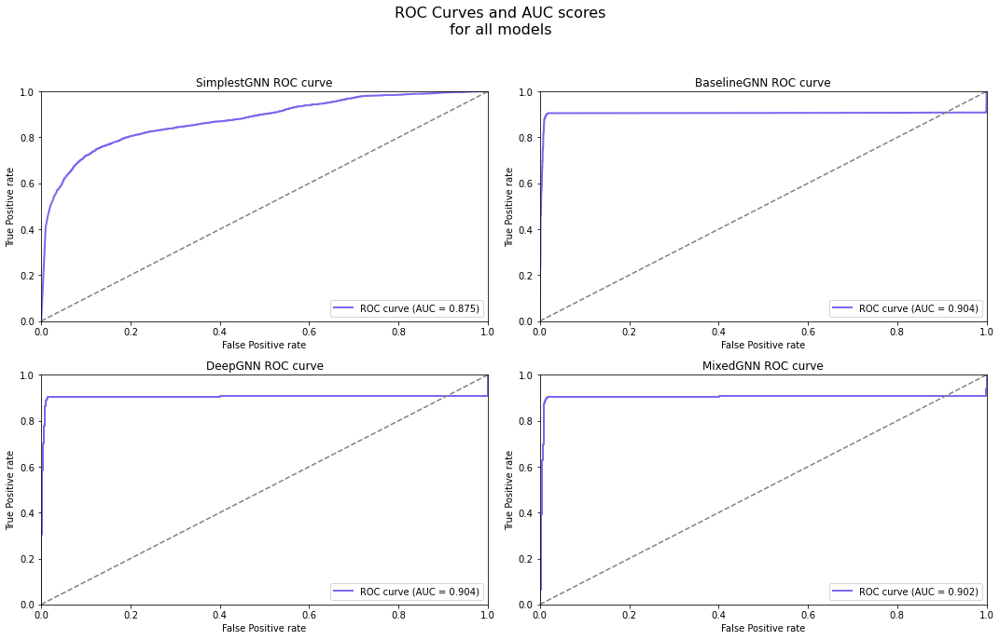

In [82]:
# Plot ROC curves for all the models
plot_roc_curves(models_list, names_list, k)

The ROC curve is highlighted in with a blue line in the plots. For the plots of $\text{BaselineGNN}$ and $\text{DeepGNN}$, the curve appears to cross the bisector line $TPR = FPR$ for *lower* classification threshold values: the TPR stays almost constant at the increase of FPR, i.e. the model is not identifying more true positives, but it is still increasing the number of false positives. It has "maxed out" its ability to find true positives. However, it's only a small region of the plot where this happens: mostly, the curve stays above the diagonal and the model can be considered effective at predicting edges.

## 4) Conclusions and future work

This work has provided valuable insights into the interactions between proteins in the context of COVID-19.

Firstly, we discovered that the network exhibits the characteristics of a **complex system**, where, despite a low overall connection density, nodes tend to form interconnected clusters in specific regions. 

Starting from this observation, in the second phase of the work we decided to experiment with three different clustering algorithms for **community detection**. The *Louvain* and *Markov Cluster* algorithms showed the most consistent results, both revealing communities that reflect the biological processes involved in COVID-19 disease. Future work could involve correlating these findings with *clinical data* to evaluate their relevance in COVID-19 context.

In the final phase of our study, our objective was to develop models capable of predicting protein interactions within the context of COVID-19 in order to allow the **forecasting of disease progression**. Our findings reveal that the proposed models exhibited strong predictive capabilities, even with simple architectures. To achieve more consistent results, future work could involve analyzing how these models perform with larger datasets and incorporating more complex features.